In [7]:
import os

In [6]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [5]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
import plotly.graph_objects as go
from skimage import exposure
import scipy.stats as st
from tqdm import tqdm
import seaborn as sns
import colorsys
import math

In [8]:
%cd /content/drive/MyDrive/DIP_src/3_assign/


/content/drive/MyDrive/DIP_src/3_assign


In [10]:
imgDIR = ""

def showImage(img, isGray=False): 
  plt.figure(figsize=(10, 10))
  if isGray:
    plt.imshow(img, cmap = 'gray')
  else:
    plt.imshow(img)
  plt.axis('off')
  plt.show()

def showImages(imgs, shown, isGray=[], titles=[], figsize=None):
  if figsize == None: 
    plt.figure(figsize=(10,10))
  else:
    plt.figure(figsize=figsize)
  for i in range(1, len(imgs)+1): 
    try:
      plt.subplot(shown[0], shown[1], i).set_title(titles[i-1])
    except: 
      plt.subplot(shown[0], shown[1], i)
    if isGray==[]:
      plt.imshow(imgs[i-1])
    elif isGray[i-1]==True:
      plt.imshow(imgs[i-1], cmap='gray')
    else:
      plt.imshow(imgs[i-1])
    plt.axis('off')
  plt.show()

def readImage(path, isGray=False):
  img = cv2.imread(imgDIR + path)
  if isGray: 
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  else:
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  return img

# Question 1

## Part 1: Median Filter

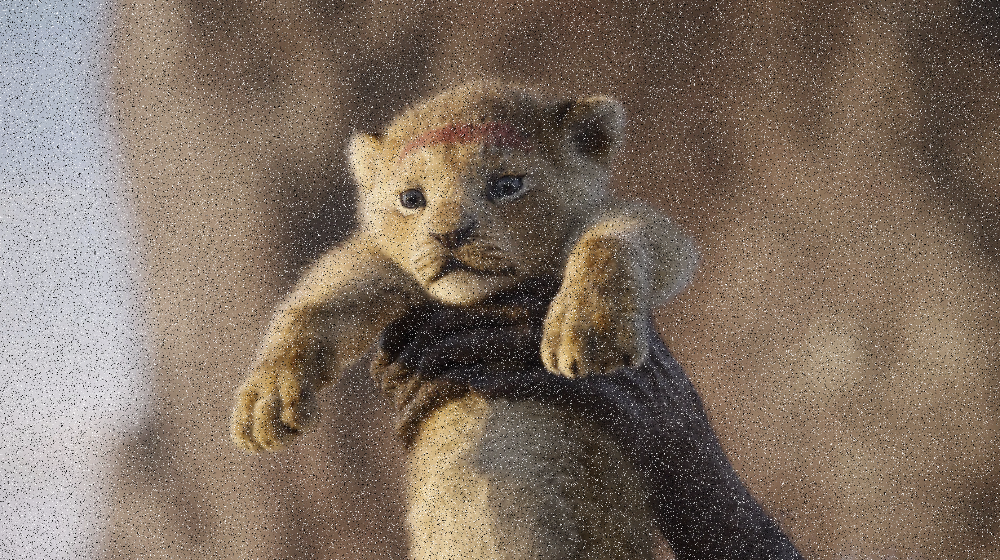

In [5]:
q1simba = cv2.imread("NoisySimba.png")
cv2_imshow(q1simba)

In [6]:
def medianFilter(img, k):
    m,n = img.shape
    h = k//2
    padded_img = np.zeros((m+2*h,n+2*h))
    padded_img[h:-h,h:-h] = img
    ret_img = np.zeros(img.shape)
    f = k%2
    for u in range(img.shape[0]):
        for v in range(img.shape[1]):
            ret_img[u][v] = np.median(np.ravel(padded_img[u:u+k,v:v+k]))
            # lis = []
            # for i in range(-h,h+f):
            #     for j in range(-h,h+f):
            #         # ret_img[u][v] += padded_img[u+i][v+j] * filt[h+i][h+j]
            #         lis.append(padded_img[u+i][v+j])
            # ret_img[u][v] = np.median(lis)
    return ret_img

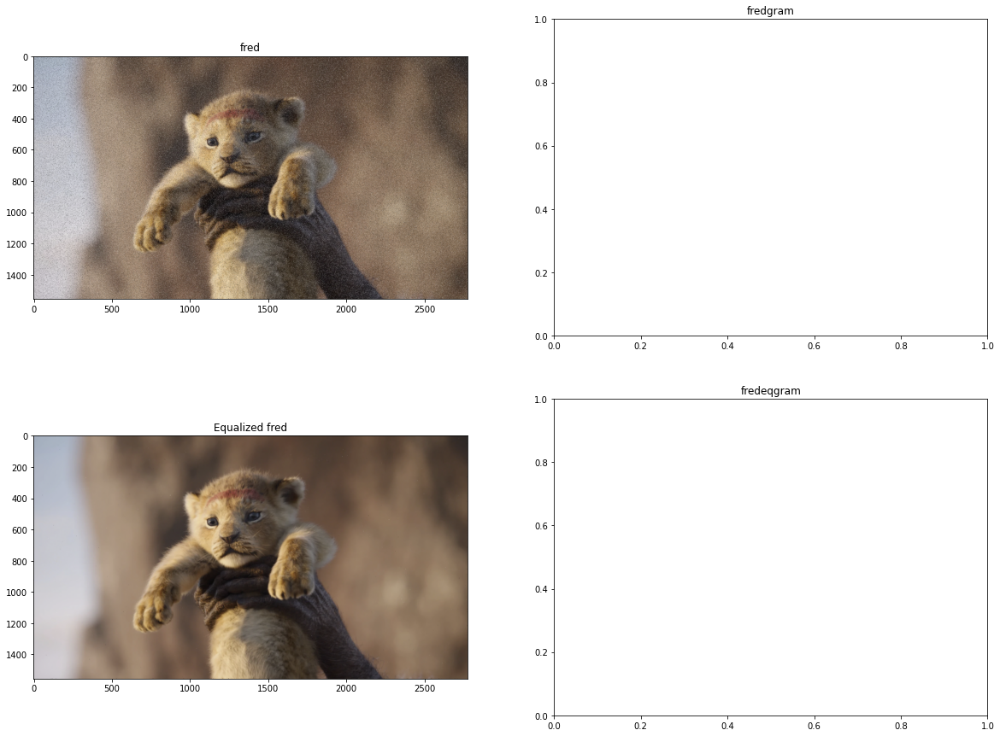

In [73]:
q1simba = cv2.imread("NoisySimba.png")
q1simba = cv2.cvtColor(q1simba, cv2.COLOR_BGR2RGB)
q1simba_b = q1simba[:,:,0]
q1simba_g = q1simba[:,:,1]
q1simba_r = q1simba[:,:,2]
# cv2_imshow(q1simba)
# plt.hist(q1simba.ravel(),256,[0,256], stacked=False); plt.show()
q1simba_final = np.dstack((medianFilter(q1simba_b,3).astype(int), medianFilter(q1simba_g,3).astype(int), medianFilter(q1simba_r,3).astype(int)))

# q1simba_final = cv2.cvtColor(q1simba_final, cv2.COLOR_BGR2RGB)

fig = plt.figure(figsize=(20,15))

# show original image
fig.add_subplot(221)
plt.title('fred')
plt.set_cmap('gray')
plt.imshow(q1simba)

fig.add_subplot(222)
plt.title('fredgram')
# plt.hist(q1simba,10,range=(0,255))

# q1simbaeq = histEqualization(q1simba)

fig.add_subplot(223)
plt.title('Equalized fred')
plt.set_cmap('gray')
plt.imshow(q1simba_final)

fig.add_subplot(224)
plt.title('fredeqgram')
# plt.hist(q1simba_final,10,range=(0,255))

plt.show()

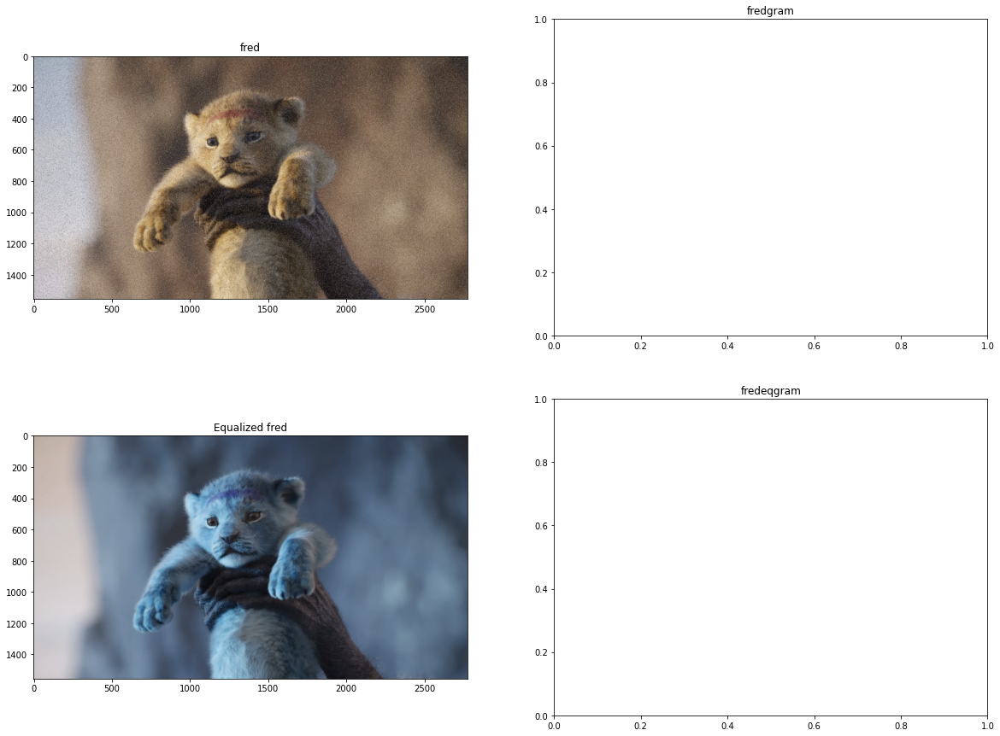

In [72]:
q1simba_final
fig = plt.figure(figsize=(20,15))

# show original image
fig.add_subplot(221)
plt.title('fred')
plt.set_cmap('gray')
plt.imshow(q1simba)

fig.add_subplot(222)
plt.title('fredgram')
# plt.hist(q1simba,10,range=(0,255))

# q1simbaeq = histEqualization(q1simba)

fig.add_subplot(223)
plt.title('Equalized fred')
plt.set_cmap('gray')
plt.imshow(q1simba_final)

fig.add_subplot(224)
plt.title('fredeqgram')
# plt.hist(q1simba_final,10,range=(0,255))

plt.show()

## Part 2: Linear Contrast Stretching

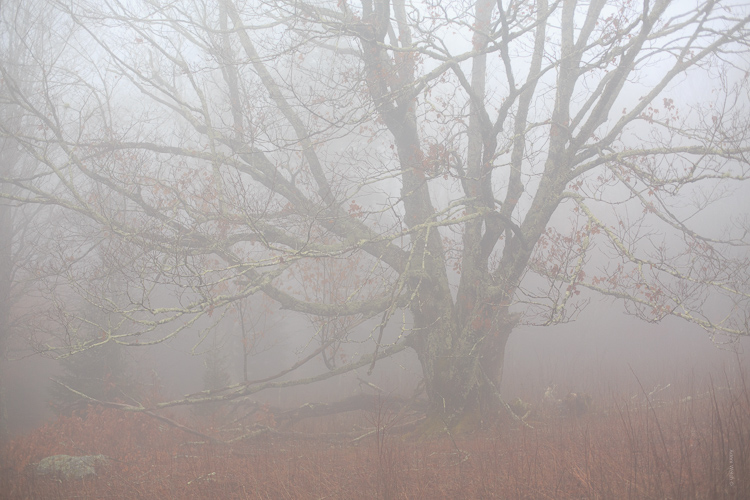

In [ ]:
q1fog = cv2.imread("fog.jpeg")
cv2_imshow(q1fog)

In [ ]:
def linContrastStretching(im, a, b):
  # cv2_imshow(im)
  min_b = np.min(im[:,:,0])
  min_g = np.min(im[:,:,1])
  min_r = np.min(im[:,:,2])
  
  max_b = np.max(im[:,:,0])
  max_g = np.max(im[:,:,1])
  max_r = np.max(im[:,:,2])

  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      im[i,j,0] = (im[i,j,0] - min_b) / (max_b - min_b) * (b-a) + a
      im[i,j,1] = (im[i,j,1] - min_g) / (max_g - min_g) * (b-a) + a
      im[i,j,2] = (im[i,j,2] - min_r) / (max_r - min_r) * (b-a) + a
  # cv2_imshow(im)
  return im

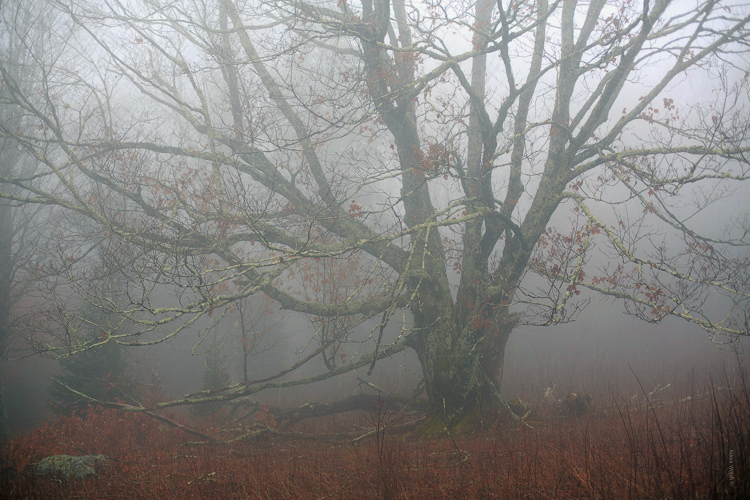

In [ ]:
q1stretched = linContrastStretching(q1fog.copy(), 0, 255)
cv2_imshow(q1stretched)

## Part 3: Histogram Equalization

In [ ]:
def histEqualization(im):
  # im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
  L = 256
  count = [0] * L
  prob = [0] * L
  target = [0] * L
  total_pixels = im.shape[0] * im.shape[1]
  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      count[im[i,j]] += 1
  prob = [x / total_pixels for x in count]

  
  sum = 0
  for i in range(L):
    sum += prob[i]
    target[i] = int((L-1)*sum)

  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      im[i,j] = target[im[i,j]]
  return im

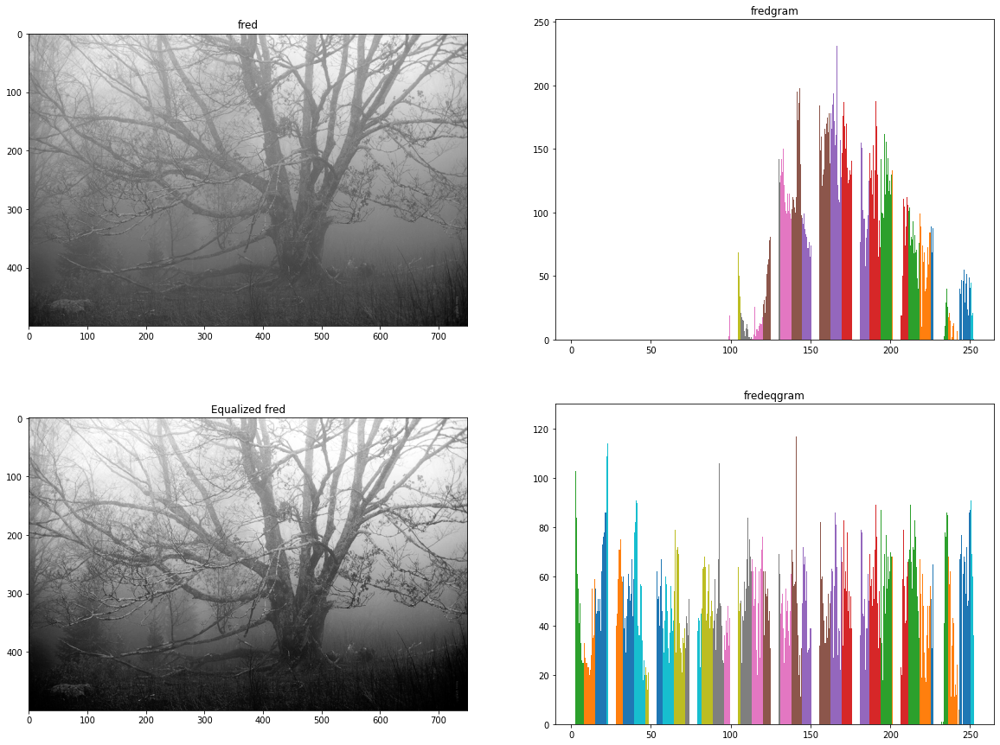

In [ ]:
q1eq = cv2.imread("fog.jpeg", 0)
# cv2_imshow(q1eq)
# plt.hist(q1eq.ravel(),256,[0,256], stacked=False); plt.show()
fig = plt.figure(figsize=(20,15))

# show original image
fig.add_subplot(221)
plt.title('fred')
plt.set_cmap('gray')
plt.imshow(q1eq)

fig.add_subplot(222)
plt.title('fredgram')
plt.hist(q1eq,10,range=(0,255))

q1eqeq = histEqualization(q1eq)

fig.add_subplot(223)
plt.title('Equalized fred')
plt.set_cmap('gray')
plt.imshow(q1eqeq)

fig.add_subplot(224)
plt.title('fredeqgram')
plt.hist(q1eqeq,10,range=(0,255))

plt.show()

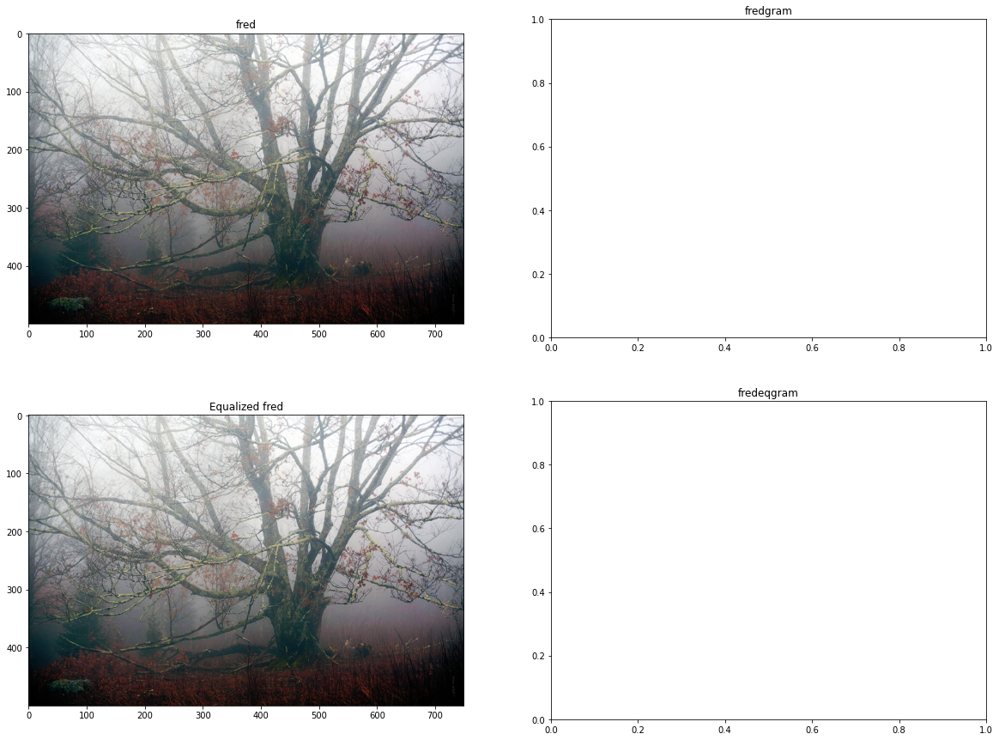

In [ ]:
q1eq = cv2.imread("fog.jpeg")
q1eq_b = q1eq[:,:,0]
q1eq_g = q1eq[:,:,1]
q1eq_r = q1eq[:,:,2]
# cv2_imshow(q1eq)
# plt.hist(q1eq.ravel(),256,[0,256], stacked=False); plt.show()
q1eq_final = np.dstack((histEqualization(q1eq_b), histEqualization(q1eq_g), histEqualization(q1eq_r)))

q1eq = cv2.cvtColor(q1eq, cv2.COLOR_BGR2RGB)
q1eq_final = cv2.cvtColor(q1eq_final, cv2.COLOR_BGR2RGB)

fig = plt.figure(figsize=(20,15))

# show original image
fig.add_subplot(221)
plt.title('fred')
plt.set_cmap('gray')
plt.imshow(q1eq)

fig.add_subplot(222)
plt.title('fredgram')
# plt.hist(q1eq,10,range=(0,255))

# q1eqeq = histEqualization(q1eq)

fig.add_subplot(223)
plt.title('Equalized fred')
plt.set_cmap('gray')
plt.imshow(q1eq_final)

fig.add_subplot(224)
plt.title('fredeqgram')
# plt.hist(q1eq_final,10,range=(0,255))

plt.show()

## Part 4: Vintage, Matrix, Vignette, Duo-tone

In [1]:
def vintageEffect(img):
  img_copy = np.copy(img)
  r, g, b = cv2.split(img_copy)
  r1 =  0.293* r + 0.769*g + 0.210*b
  g1 = 0.249* r + 0.686*g + 0.188*b
  b1 = 0.172* r + 0.534*g + 0.151*b
  r1 = np.clip(r1, 0, 255)
  g1 = np.clip(g1, 0, 255)
  b1 = np.clip(b1, 0, 255)
  output = [r1, g1, b1]
  output = np.stack(output, axis=2)
  output = np.round(output)
  output = np.uint8(output)
  return output

def matrixEffect(img):
  img_copy = np.copy(img)
  r, g, b = cv2.split(img_copy)
  r1 =  np.power(r, 3/2)
  g1 = np.power(g, 4/5)
  b1 = np.power(b, 3/2)
  r1 = np.clip(r1, 0, 255)
  g1 = np.clip(g1, 0, 255)
  b1 = np.clip(b1, 0, 255)
  output = [r1, g1, b1]
  output = np.stack(output, axis=2)
  output = np.round(output)
  output = np.uint8(output)
  return output

def vignettingEffect(img):
  output = np.copy(img)
  texture = readImage('vignetting.jpg', True)
  texture = cv2.resize(texture, output.shape[::-1][1:3])
  texture = np.double(texture)/255
  for i in range(3):
    output[:, :, i] = np.double(output[:, :, i]) * np.double(texture)
  output = np.round(output)
  output = np.uint8(output) 
  return output

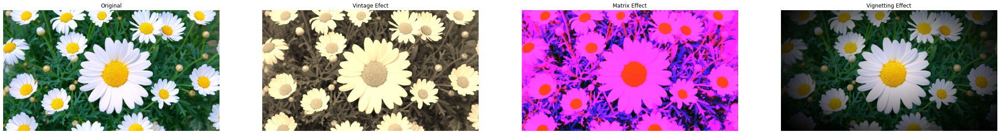

In [14]:
Keanu = readImage('flower.jpeg')
vintageeffect = vintageEffect(Keanu)
matrixeffect = matrixEffect(Keanu)
vignettingeffect = vignettingEffect(Keanu)  
showImages([Keanu, vintageeffect, matrixeffect, vignettingeffect], 
           [1, 4], 
           [False, False, False, False], 
           ['Original', 'Vintage Efect', 'Matrix Effect', 'Vignetting Effect'], 
           (40, 10))

# Question 2: Cell

## Part 1: Cell, Flower

In [10]:
def dilation(img,r):
    img_final =  np.zeros(img.shape)
    d = r//2
    img = np.pad(img,((d,d),(d,d)),"constant")
    for i in range(img_final.shape[0]):
        for j in range(img_final.shape[1]):
            img_final[i,j] = img[i:i+r,j:j+r].max()
    return img_final

In [11]:
def erosion(img,r):
    img_final =  img.copy()
    d = r//2
    img = np.pad(img,((d,d),(d,d)),"constant")
    for i in range(img_final.shape[0]):
        for j in range(img_final.shape[1]):
            img_final[i,j] = (img[i:i+r,j:j+r]).min()
    return img_final  

In [12]:
def twopass_cell(img, onesize):
    in_img = np.zeros(img.shape)
    in_img[img==0] = -1
    h,w = img.shape
    ind = 1
    arr = np.ones(onesize)*-1
    for i in range(1,h):
        for j in range(1,w):
            if img[i,j] == 1:
                k1 = in_img[i-1,j]
                k2 = in_img[i,j-1]
                k1,k2 = max(k1,k2),min(k1,k2)
                if k1 == -1:
                    in_img[i,j] = ind
                    ind = ind + 1
                elif k2 == -1 or k1 == k2 :
                    in_img[i,j] = k1
                else :
                    in_img[i,j] = k2
                    #print(k1,k2)
                    arr[math.floor(k1)] = int(k2)
    for i in range(1,ind)[::-1]:
        if arr[i] == -1:
            pass
        else :
            in_img[in_img == i] = arr[i]
    return in_img


In [13]:
def twopass(img):
    img_fin = np.zeros(img.shape)
    img_fin[img==0] = -1
    h,w = img.shape
    ind = 1
    arr = np.ones(2000)*-1
    for i in range(1,h):
        for j in range(1,w):
            if img[i,j] == 1:
                k1 = img_fin[i-1,j]
                k2 = img_fin[i,j-1]
                k1,k2 = max(k1,k2),min(k1,k2)
                if k1 == -1:
                    img_fin[i,j] = ind
                    ind = ind + 1
                elif k2 == -1 or k1 == k2 :
                    img_fin[i,j] = k1
                else :
                    img_fin[i,j] = k2
                    arr[int(k1)] = int(k2)
    for i in range(1,ind)[::-1]:
        if arr[i] == -1:
            pass
        else :
            img_fin[img_fin == i] = arr[i]
    return img_fin


In [14]:
np.ones(5)*-1

array([-1., -1., -1., -1., -1.])

In [15]:
def random_colors(N):
    brightness = 2  
    hsv = [(i/(N+1), i/2*N, brightness) for i in range(N)]
    colors = list(map(lambda c: colorsys.hsv_to_rgb(*c), hsv))
    return np.array(colors)

In [16]:
q2cell = cv2.imread("cell.png",0)
q2cell = (q2cell > 128).astype(np.int64)
q2cell = dilation(erosion(q2cell,11),11)
a= twopass_cell(q2cell, 500)
img = np.zeros((q2cell.shape[0],q2cell.shape[1],3))

In [17]:
q2cell.shape

(818, 1024)

(42, 3)


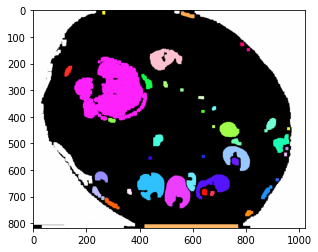

In [18]:
colors = random_colors(np.unique(a).size-1)

print(colors.shape)
c=0
for i in np.unique(a)[1:]:
    img[a == i,:] = colors[c,:]*255
    c += 1 
plt.imshow(img.astype(np.uint8))

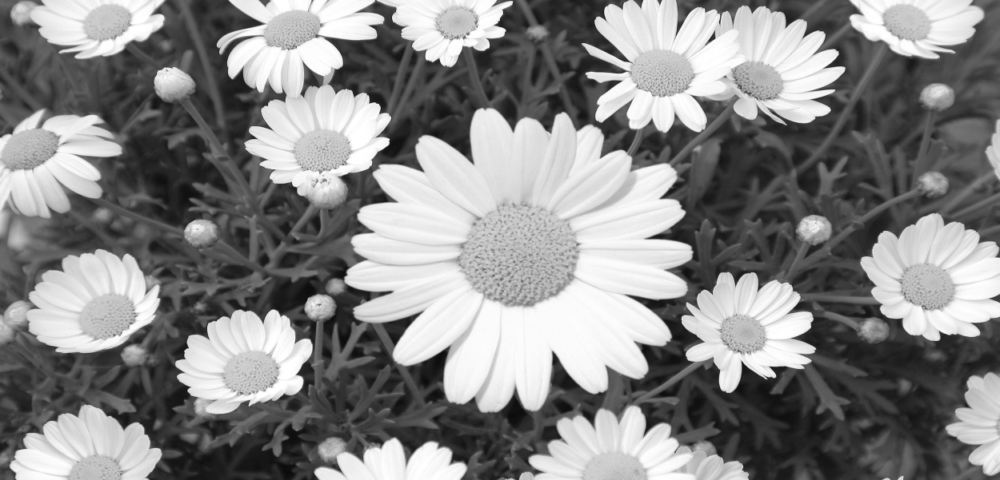

In [23]:
q2flower = cv2.imread("flower.jpeg",0)
q2flower.shape
q2flower = cv2.resize(q2flower, (1250, 601), interpolation = cv2.INTER_AREA)
cv2_imshow(q2flower)

In [52]:
q2flower = cv2.imread("flower.jpeg",0)
np.min(q2flower)

0

In [57]:
q2flower = cv2.imread("flower.jpeg",0)
q2flower = cv2.resize(q2flower, (1250, 601), interpolation = cv2.INTER_AREA)
q2flower = (q2flower > 128).astype(np.int64)
q2flower = dilation(erosion(q2flower,11),11)

In [58]:
a= twopass_cell(q2flower, 2000)
img = np.zeros((q2flower.shape[0],q2flower.shape[1],3))


(25, 3)


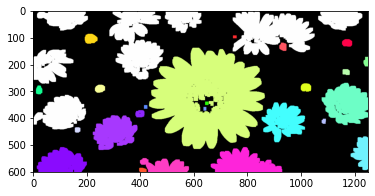

In [59]:
colors = random_colors(np.unique(a).size-1)

print(colors.shape)
c=0
for i in np.unique(a)[1:]:
    img[a == i,:] = colors[c,:]*255
    c += 1 
plt.imshow(img.astype(np.uint8))

## Part 2: Objects

count no of pixels for each cluster


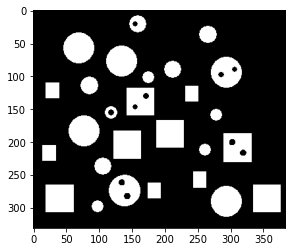

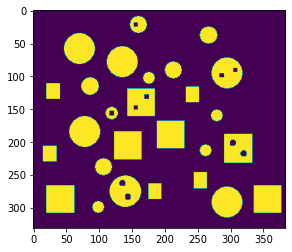

27
count no of pixels after closing


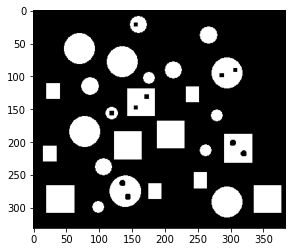

6  objects have one or more holes


In [61]:
#finding number of pixels in closing and orginal 
I = cv2.imread("objects.png",0)
I = (I > 127).astype(np.float64)
plt.imshow(I,cmap="gray")
print("count no of pixels for each cluster")
plt.show()
a= twopass(I)
un1,count1 = np.unique(a,return_counts=True)
I = erosion(dilation(I,4),4)
plt.imshow(I)
plt.show()
b = twopass(I)

un2,count2 = np.unique(b,return_counts=True)

ans = 0
tot = 0
for i in range(1,un2.size):
    if count1[i] != count2[i]:
        ans += 1
    tot += 1
print(tot)

print("count no of pixels after closing")
plt.imshow(I,cmap="gray")
plt.show()
print(str(ans)+"  objects have one or more holes")

### Shapes

sides     holes
23     20    no
23     19    no
41     41    yes
41     41    no
42     41    no
43     42    yes
23     20    no
24     19    no
23     19    no
41     42    no
41     41    no
no of rectangles 11


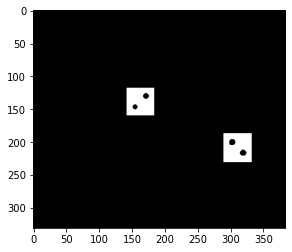

In [63]:
I = cv2.imread("objects.png",0)
I = (I > 127).astype(np.float64)
a= twopass(I)
ans = 0
un1,count1 = np.unique(a,return_counts=True)
I = erosion(dilation(I,4),4)
b = twopass(I)
un2,count2 = np.unique(b,return_counts=True)
print("sides     holes")
J = np.zeros(I.shape)
for i in range(1,un1.size):
    row,col = np.where(a==un1[i])
    if a[row.min(),col.min()]==un1[i]:
            print(row.max()-row.min(),"   ",col.max()-col.min(),end="    ")
            ans +=1
            if count2[i]==count1[i]:
                print("no")
            else:
                J[a==un1[i]] = 1
                print("yes")
plt.imshow(J,cmap="gray")
print("no of rectangles" ,ans)

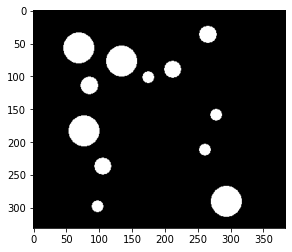

In [64]:
I = cv2.imread("objects.png",0)
I = (I > 127).astype(np.float64)
a= twopass(I)
ans = 0
un1,count1 = np.unique(a,return_counts=True)
I = erosion(dilation(I,4),4)
b = twopass(I)
un2,count2 = np.unique(b,return_counts=True)
J = np.zeros(I.shape)
for i in range(1,un1.size):
    row,col = np.where(a==un1[i])
    if a[row.min(),col.min()]!=un1[i]:
            if count2[i]==count1[i]:
                J[a==un1[i]] = 1
plt.imshow(J,cmap="gray")

## Part 3: Circles

### Touching boundary

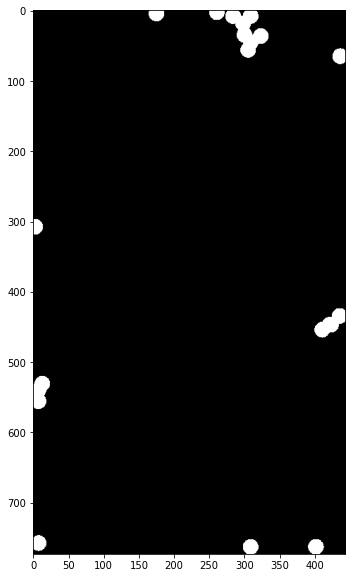

In [65]:
coins = cv2.imread("circles.jpg",0)
coins = (coins > 127).astype(np.float64)
coins = np.pad(coins,((1,1),(1,1)),"constant",constant_values=1)
coins = np.pad(coins,((1,1),(1,1)),"constant")
a= twopass(coins)
coins[a!=1]=0
coins = coins[2:-2,2:-2]
plt.figure(figsize=(10,10))
plt.imshow(coins,cmap='gray')

### Overlapping

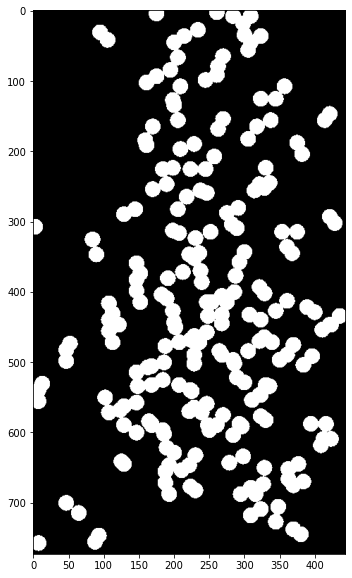

In [66]:
coins = cv2.imread("circles.jpg",0)
coins = (coins > 127).astype(np.float64)
plt.figure(figsize=(10,10))
plt.imshow(coins,cmap="gray")
a= twopass(coins)
un,c=np.unique(a,return_counts=True)
r = 20
for i in range(c.size):
    if c[i] < r*r:
        coins[a==un[i]] =0
plt.imshow(coins,cmap="gray")

### Non-overlapping

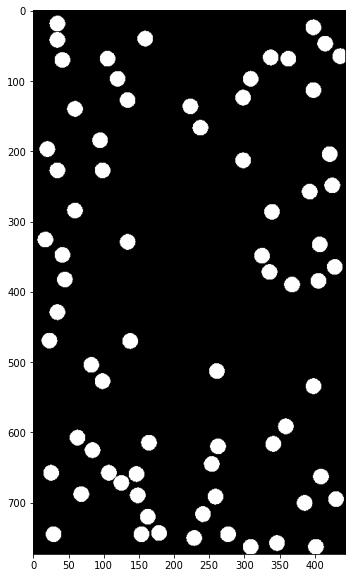

In [67]:
coins = cv2.imread("circles.jpg",0)
coins = (coins > 127).astype(np.float64)
plt.figure(figsize=(10,10))
plt.imshow(coins,cmap="gray")
a= twopass(coins) 
un,c=np.unique(a,return_counts=True)
r = 21
for i in range(c.size):
    if c[i] > r*r:
        coins[a==un[i]] =0
plt.imshow(coins,cmap="gray")

73


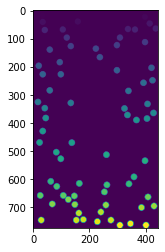

In [68]:
a= twopass(coins)
plt.imshow(a)
un,c=np.unique(a,return_counts=True)
print(len(un))

# Question 3

## Part 1: Thresholding

In [ ]:
def twopass(img):
    img_fin = np.zeros(img.shape)
    img_fin[img==0] = -1
    h,w = img.shape
    ind = 1
    arr = np.ones(2000)*-1
    for i in range(1,h):
        for j in range(1,w):
            if img[i,j] == 1:
                k1 = img_fin[i-1,j]
                k2 = img_fin[i,j-1]
                k1,k2 = max(k1,k2),min(k1,k2)
                if k1 == -1:
                    img_fin[i,j] = ind
                    ind = ind + 1
                elif k2 == -1 or k1 == k2 :
                    img_fin[i,j] = k1
                else :
                    img_fin[i,j] = k2
                    arr[int(k1)] = int(k2)
    for i in range(1,ind)[::-1]:
        if arr[i] == -1:
            pass
        else :
            img_fin[img_fin == i] = arr[i]
    return img_fin


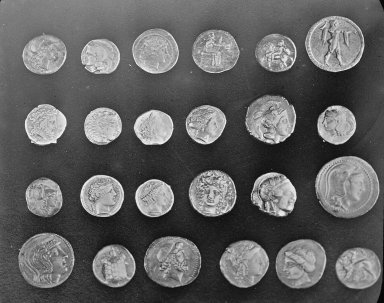

In [ ]:
coins = cv2.imread("coins.png")
cv2_imshow(coins)

In [ ]:
print(np.array(coins).shape)
r = np.array(coins)[:,:,0]
g = np.array(coins)[:,:,1]
b = np.array(coins)[:,:,2]
print(np.min(r))
print(np.min(g))
print(np.min(b))
print(np.max(r))
print(np.max(g))
print(np.max(b))

(303, 384, 3)
1
1
1
252
252
252


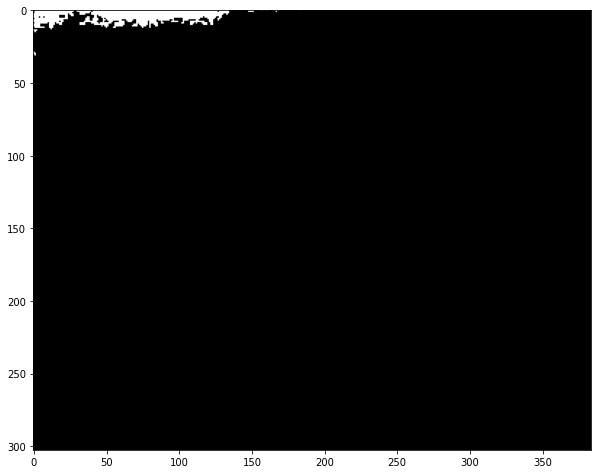

In [ ]:
coins = cv2.imread("coins.png",0)
coins = (coins > 127).astype(np.float64)
coins = np.pad(coins,((1,1),(1,1)),"constant",constant_values=1)
coins = np.pad(coins,((1,1),(1,1)),"constant")
a= twopass(coins)
coins[a!=1]=0
coins = coins[2:-2,2:-2]
plt.figure(figsize=(10,10))
plt.imshow(coins,cmap='gray')

401


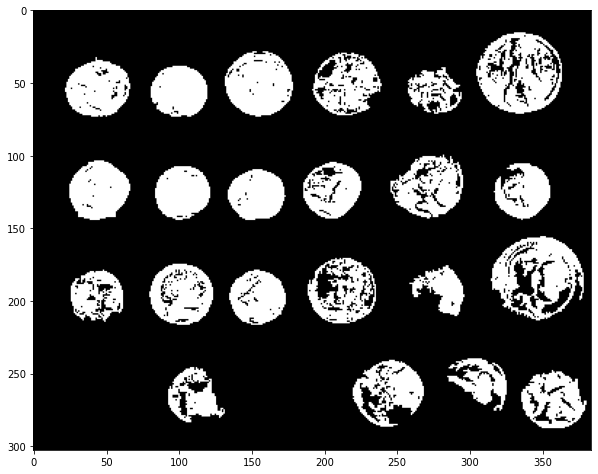

In [ ]:
coins = cv2.imread("coins.png",0)
coins = (coins > 140).astype(np.float64)
plt.figure(figsize=(10,10))
plt.imshow(coins,cmap="gray")
a= twopass(coins)
un,c=np.unique(a,return_counts=True)
r = 20
for i in range(c.size):
    if c[i] < r*r:
        coins[a==un[i]] =0
plt.imshow(coins,cmap="gray")

print(len(un))

(401,)
(400, 3)


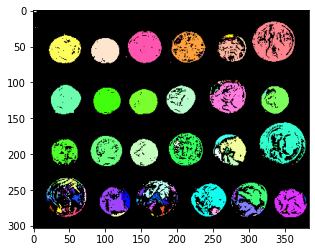

In [ ]:
img = np.zeros((coins.shape[0],coins.shape[1],3))
print(np.unique(a).shape)
colors = random_colors(np.unique(a).size-1)

print(colors.shape)
c=0
for i in np.unique(a)[1:]:
    img[a == i,:] = colors[c,:]*255
    c += 1 
plt.imshow(img.astype(np.uint8))

In [ ]:
# coins = cv2.imread("coins.png",0)
# coins = (coins > 127).astype(np.float64)
# plt.figure(figsize=(10,10))
# plt.imshow(coins,cmap="gray")
# a= twopass(coins)
# un,c=np.unique(a,return_counts=True)
# r = 21
# for i in range(c.size):
#     if c[i] > r*r:
#         coins[a==un[i]] =0
# plt.imshow(coins,cmap="gray")

In [ ]:
# coins = cv2.imread("coins.png",0)
# coins = (coins > 127).astype(np.float64)
# plt.figure(figsize=(10,10))
# plt.imshow(coins,cmap="gray")
# a= twopass(coins)
# un,c=np.unique(a,return_counts=True)
# r = 20
# for i in range(c.size):
#     if c[i] > r*r:
#         coins[a==un[i]] =0
# plt.imshow(coins,cmap="gray")

### Otsu's Method

107.0


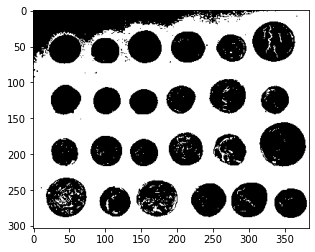

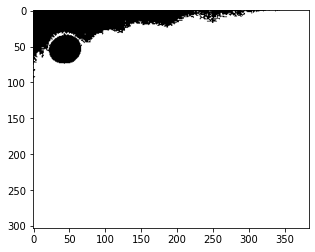

In [227]:
#finding number of pixels in closing and orginal 
#image1 = cv2.imread("/content/drive/MyDrive/M2020/Assignment_3/images/coinss.jpeg")
#img = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
  
# applying Otsu thresholding
# as an extra flag in binary 
# thresholding     
coins = cv2.imread("coins.png",0)
ret, thresh1 = cv2.threshold(coins, 160, 255, cv2.THRESH_OTSU)     
  
# the window showing output image         
# with the corresponding thresholding         
# techniques applied to the input image    
print(ret)
from scipy import ndimage as ndi
thresh1 = 255-thresh1
plt.imshow(thresh1)
plt.show()
fill_coins = ndi.binary_fill_holes(thresh1)
plt.imshow(fill_coins)
plt.show()

### Observations
* In manual thresholding, the optimal value was found to be 140. It returned 400.
* In Otsu's method, the return value was 107 which is much closer to the true number of coins.

Since the image is grayscale with low contrast, it is difficult to count the number of coins.
If we first apply thresholding and and then mean filter we could get a much closer count.


## Part 2: Segmentation

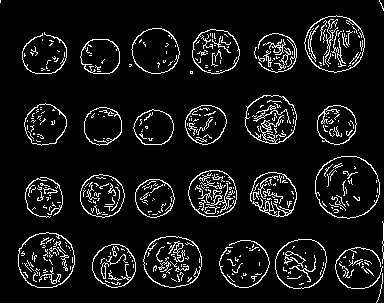

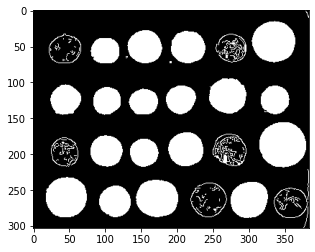

In [213]:
coins = cv2.imread("coins.png", 0)
edges = cv2.Canny(coins, 150, 240)
cv2_imshow(edges)

from scipy import ndimage as ndi

fill_coins = ndi.binary_fill_holes(edges)
plt.imshow(fill_coins)

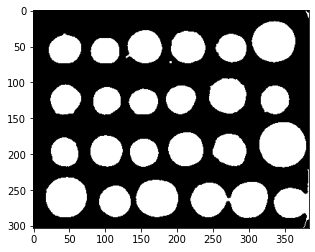

In [214]:
import skimage.morphology as morp
closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, morp.disk(3))
plt.imshow(closed)

fill_coins = ndi.binary_fill_holes(closed)
plt.imshow(fill_coins)

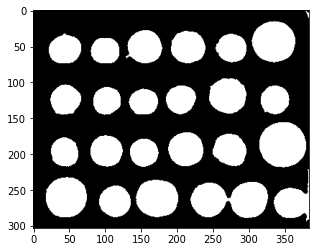

In [217]:
coins_cleaned = morp.remove_small_objects(fill_coins, 21)
plt.imshow(coins_cleaned)

(24, 3)


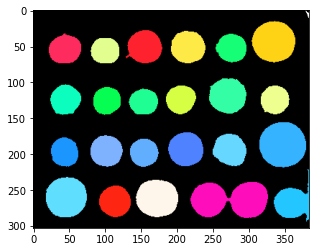

In [219]:
a= twopass_cell(coins_cleaned, 500)
img = np.zeros((coins_cleaned.shape[0],coins_cleaned.shape[1],3))

colors = random_colors(np.unique(a).size-1)

print(colors.shape) 
c=0
for i in np.unique(a)[1:]:
    img[a == i,:] = colors[c,:]*255
    c += 1 
plt.imshow(img.astype(np.uint8))

## Part 3: Observations

Here we see that segmentation along with morphological operations we get an accurate count of coins unlike thresholding.

# Question 4

### Part 1

In [ ]:
import skimage.morphology as morp
kernel = np.ones((3, 3), np.uint8)

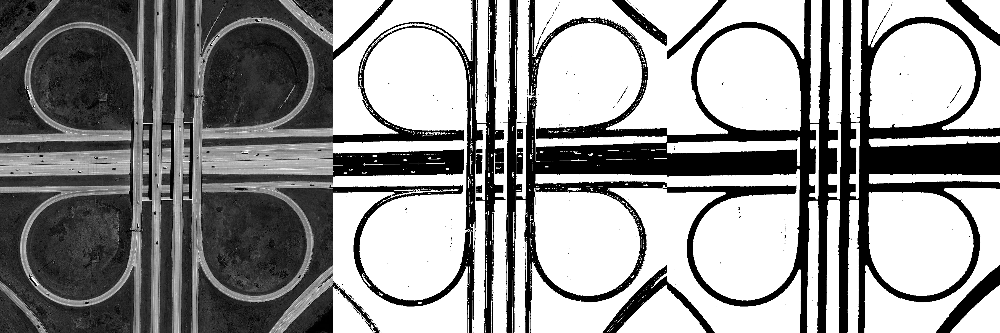

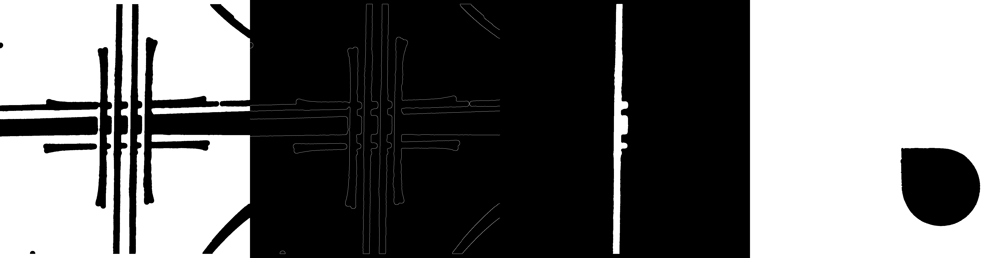

In [ ]:
road = cv2.imread('roads.jpg',0)
ret, thresh = cv2.threshold(road,120,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C)
ele = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
ele = ele.astype(np.int8)
ele[0] = -1
ele[-1] = -1
# ele[2:-2] = -1
# print(ele)
opened = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, morp.disk(5))

closed = cv2.morphologyEx(opened, cv2.MORPH_CLOSE, morp.disk(13))
# opened = 255 - opened
ker = np.array([[1,-1,1],[1,-1,1],[1,-1,1]])
# closed=cv2.morphologyEx(opened,cv2.MORPH_HITMISS,ele)
im = np.full((road.shape[0]+40,road.shape[1]),255)
im[20:-20,:] = closed
closed = im.astype(np.uint8)

edges = cv2.Canny(closed, 100, 200)
#edges = cv2.dilate(edges, kernel) 
contours = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# pp = contours[0]

contours1 = contours[0] if len(contours) == 2 else contours[1]
big_contour1 = max(contours1, key=cv2.contourArea)

# draw white filled contour on black background
result0 = np.zeros_like(closed)
cv2.drawContours(result0, [big_contour1 ], 0, (255,255,255), cv2.FILLED)

# from scipy import ndimage as ndi

# fill_coins = ndi.binary_fill_holes(edges)

# opened1 = cv2.morphologyEx(closed, cv2.MORPH_OPEN, morp.disk(5))
cv2_imshow(np.hstack([road, thresh, opened,]))
cv2_imshow(np.hstack([closed, edges, result0, temp]))

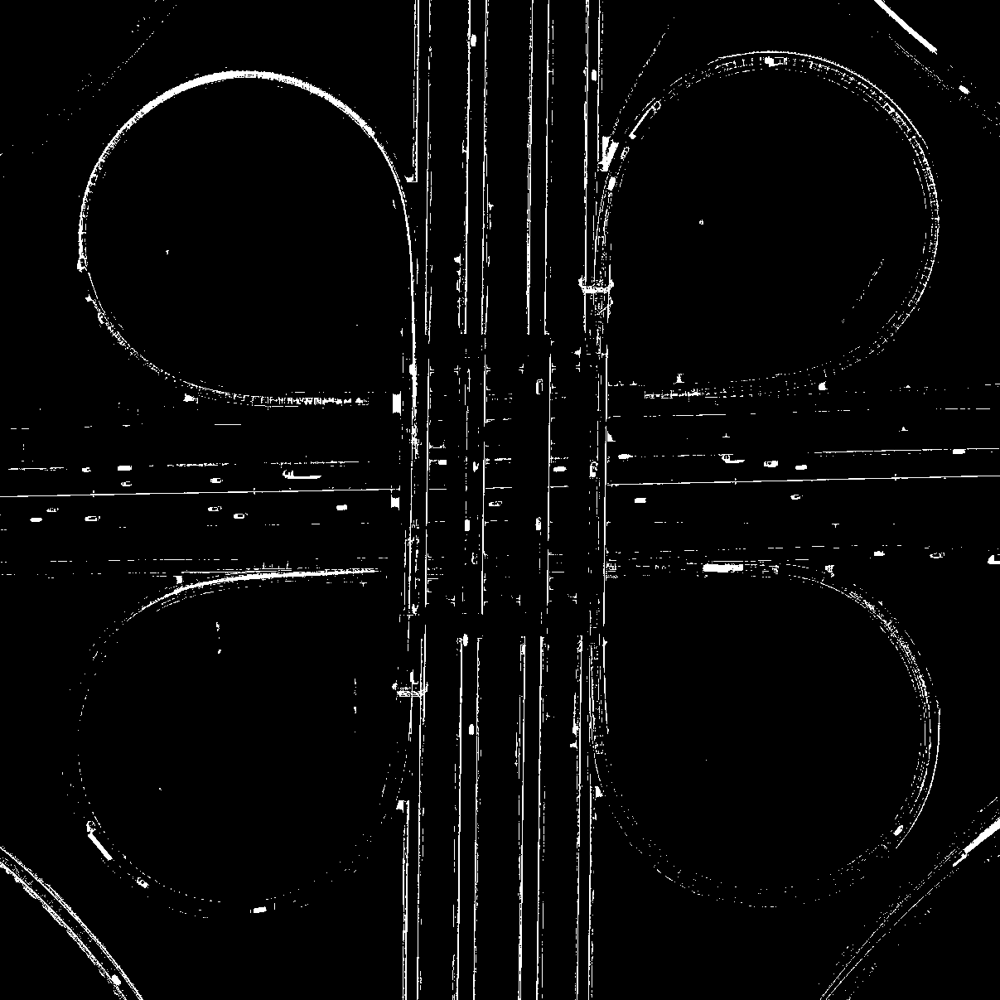

In [ ]:
lll = thresh - opened
cv2_imshow(lll)

In [ ]:
temp = 255-result0
a1 = np.copy(closed)
a2 = np.copy(temp)
a3 = np.copy(a1)
print(a2.shape)
for i in range(a2.shape[0]) :
    for j in range(a2.shape[1]) :
        if a2[i,j] == a1[i,j] :
            a3[i,j] = 255

#for i in range(temp.)

(1247, 1207)


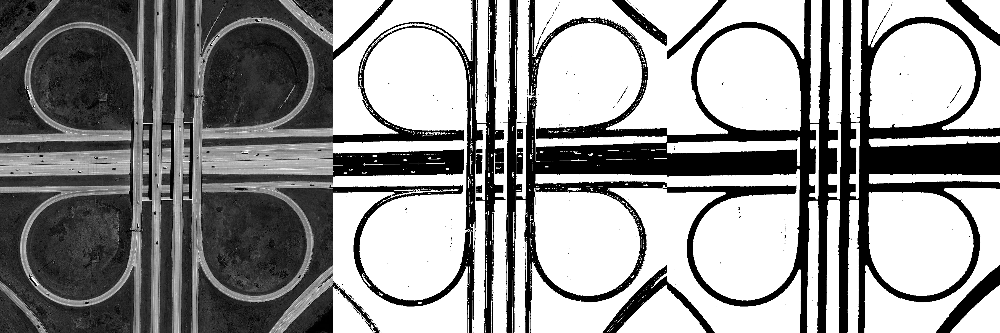

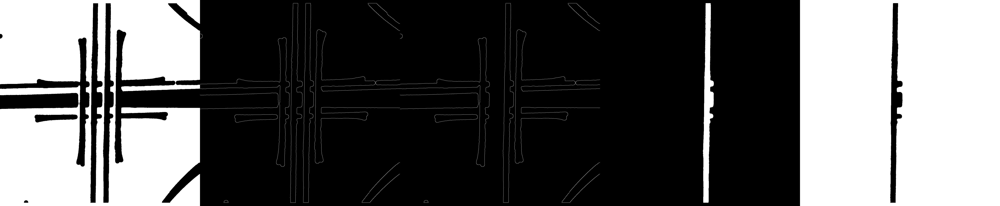

In [ ]:
edges1 = cv2.Canny(a3, 100, 200)
#edges1 = cv2.dilate(edges1, kernel) 
contours = cv2.findContours(edges1, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# pp = contours[0]

contours1 = contours[0] if len(contours) == 2 else contours[1]
big_contour1 = max(contours1, key=cv2.contourArea)

# draw white filled contour on black background
result1 = np.zeros_like(closed)
cv2.drawContours(result1, [big_contour1 ], 0, (255,255,255), cv2.FILLED)

# from scipy import ndimage as ndi

# fill_coins = ndi.binary_fill_holes(edges1)

# opened1 = cv2.morphologyEx(closed, cv2.MORPH_OPEN, morp.disk(5))
cv2_imshow(np.hstack([road, thresh, opened,]))
cv2_imshow(np.hstack([closed, edges, edges1, result1, temp]))

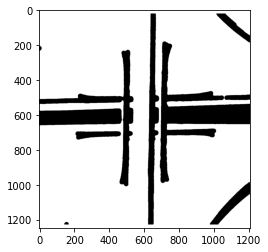

In [ ]:
plt.imshow(a3)

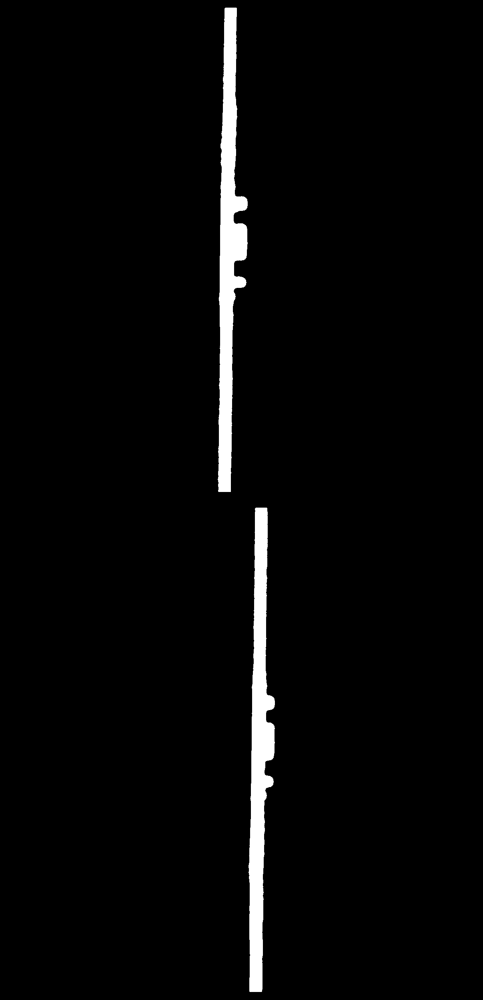

In [ ]:
cv2_imshow(np.vstack([ result0, result1]))

In [ ]:
res = np.copy(result0)
for i in range(result0.shape[0]) :
    for j in range(result0.shape[1]) : 
        if result1[i,j] == 255 :
            res[i,j] = 255

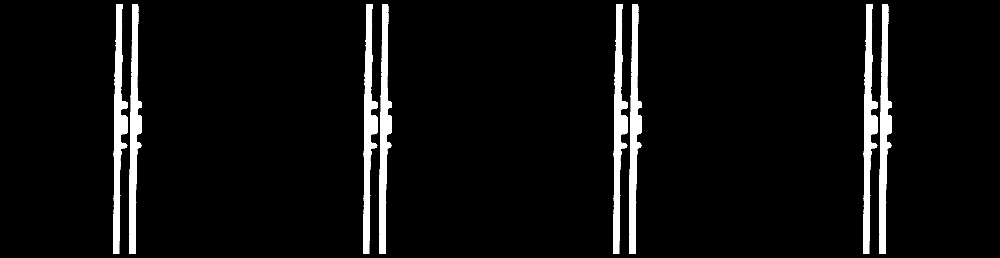

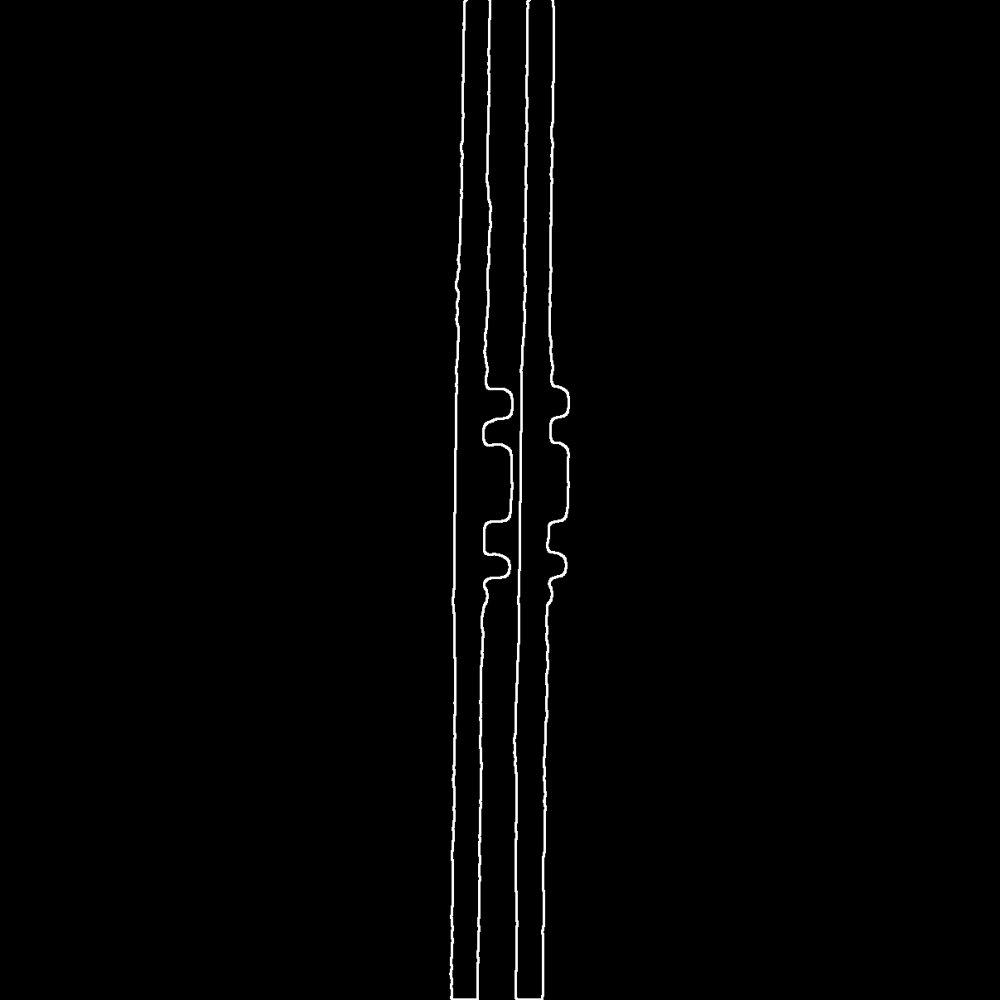

In [ ]:
res_edges = cv2.Canny(res, 200, 600)
res_edges = cv2.dilate(res_edges, kernel)
cv2_imshow(np.hstack([ res, res, res, res]))
cv2_imshow(np.hstack([  res_edges[20:-20, :]]))

## Part 2

In [ ]:
def connectedComponents(img,color=True):
    b, l = img.shape
    count = 1
    comp = np.zeros(img.shape)
    uf = np.arange(0,10000,1)
    for i in range(b):
        for j in range(l):
            if img[i][j] != 0:
                if (j>=1 and img[i][j-1] == img[i][j]):
                    comp[i][j] = comp[i][j-1]
                elif (i>=1 and img[i-1][j] == img[i][j]) and (j>=1 and img[i][j-1] != img[i][j]):
                    comp[i][j] = comp[i-1][j]
                else:
                    comp[i][j] = count
                    count+=1
                if (i>=1 and img[i-1][j] == img[i][j]) and (j>=1 and img[i][j-1] == img[i][j]) and comp[i-1][j]!=comp[i][j-1]:
                    maxm, minm = int(max(comp[i-1][j],comp[i][j-1])), int(min(comp[i-1][j],comp[i][j-1]))
                    comp[i][j] = minm
                    uf[maxm] = minm  
    for i in range(1,count+1):
        ind = i
        while uf[ind] != ind:
            ind = uf[ind]
        uf[i] = ind
    comp_2pass = uf[comp.astype('int')]
    if not color:
        return comp_2pass, len(np.unique(comp_2pass)) - 1
    colors = np.random.randint(0,255,(count+1,3))
    colors[0,:] = 0
    colors[1,:] = 255
    return colors[comp_2pass].astype('uint8') , len(np.unique(comp_2pass)) - 1

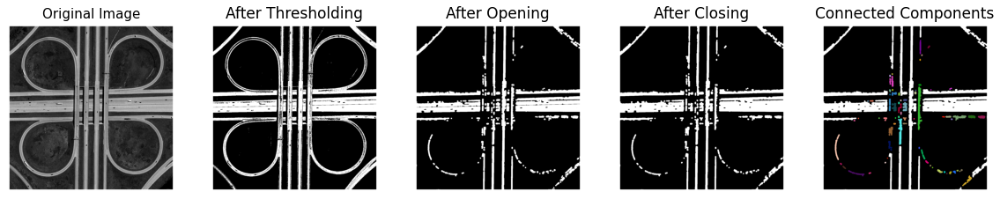

In [ ]:
from skimage import morphology as morp
# kidney = cv2.imread("/content/cell.png",0)
road_src = cv2.imread('roads.jpg', 0)
road = road_src.copy()
im = np.full((road.shape[0]+50,road.shape[1]+50),255)
im[25:-25,25:-25] = road
road = im.astype(np.uint8)
ret,road_thresh = cv2.threshold(road,130,255,cv2.THRESH_BINARY)
opened = cv2.morphologyEx(road_thresh, cv2.MORPH_OPEN, morp.disk(5))
closed = cv2.morphologyEx(opened, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5)))
con, count = connectedComponents(closed)

# cv2_imshow(np.hstack([road, road_thresh, opened, closed, con]))
fig, ax = plt.subplots(1,5)
fig.set_figheight(20)
fig.set_figwidth(20)

ax[0].imshow(road,cmap='gray')
ax[0].set_title("Original Image", fontsize=15)
ax[0].axis('off')
ax[1].imshow(road_thresh,cmap='gray')
ax[1].set_title("After Thresholding", fontsize=17)
ax[1].axis('off')
ax[2].imshow(opened,cmap='gray')
ax[2].set_title("After Opening", fontsize=17)
ax[2].axis('off')
ax[3].imshow(closed,cmap='gray')
ax[3].set_title("After Closing", fontsize=17)
ax[3].axis('off')
ax[4].imshow(con)
ax[4].set_title("Connected Components", fontsize=17)
ax[4].axis('off')
fig.show()
# fig = plt.figure(figsize=(10,10))
# ax1 = fig.add_subplot(221)
# ax2 = fig.add_subplot(222)
# ax1.title.set_text('Cell Image')
# ax2.title.set_text('Expected Output')
# ax1.axis('off')
# ax1.imshow(road, cmap='gray')
# ax2.axis('off')
# ax2.imshow(con)
# fig.show()

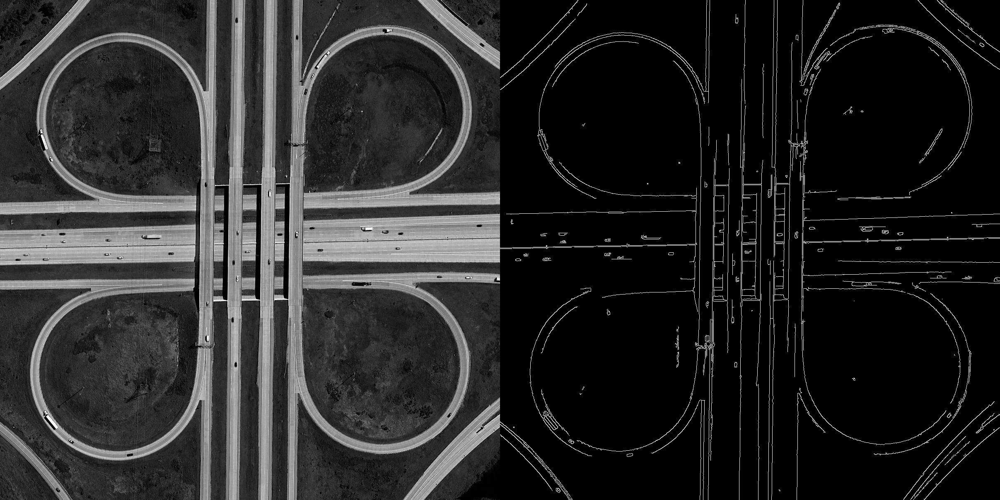

In [ ]:
road_src = cv2.imread('roads.jpg',0)
road_edges = cv2.Canny(image=road_src, threshold1=600, threshold2=200) # Canny Edge Detection
cv2_imshow(np.hstack([road_src, road_edges]))

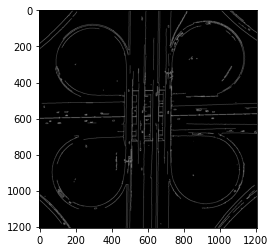

In [ ]:
plt.imshow(road_edges)

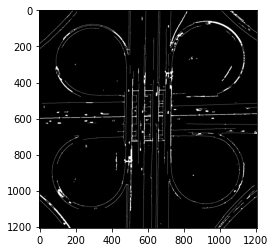

In [ ]:
edge_ret,edge_thresh = cv2.threshold(road_edges,160,255,cv2.THRESH_BINARY)
closed = cv2.morphologyEx(edge_thresh, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5)))
edge_ret,edge_thresh = cv2.threshold(closed,10,255,cv2.THRESH_BINARY)
opened = cv2.morphologyEx(closed, cv2.MORPH_OPEN, morp.disk(1))
plt.imshow(edge_thresh)
# plt.imshow(opened)

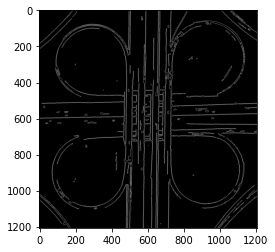

In [ ]:
edges = cv2.Canny(closed, 200, 300)
edge_ret,edge_thresh = cv2.threshold(road_edges,0,255,cv2.THRESH_BINARY)
closed = cv2.morphologyEx(edge_thresh, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5)))
plt.imshow(opened)

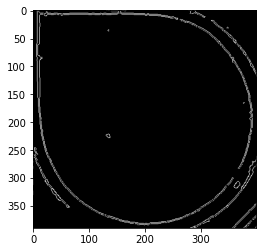

In [ ]:
# ttt = opened[90:500, 90:500]
ttt = opened[690:1080, 720:1120]
plt.imshow(ttt)

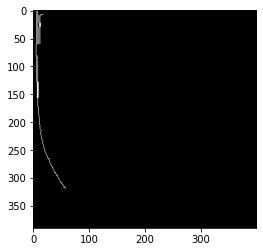

In [ ]:
edgese = cv2.Canny(ttt, 100, 200)
#edgese = cv2.dilate(edgese, kernel) 
contours = cv2.findContours(edgese, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# pp = contours[0]

contours1 = contours[0] if len(contours) == 2 else contours[1]
big_contour1 = max(contours1, key=cv2.contourArea)

# draw white filled contour on black background
result0 = np.zeros_like(ttt)
cv2.drawContours(result0, [big_contour1 ], 0, (255,255,255), cv2.FILLED)

# from scipy import ndimage as ndi

# fill_coins = ndi.binary_fill_holes(edgese)

# opened1 = cv2.morphologyEx(closed, cv2.MORPH_OPEN, morp.disk(5))
#cv2_imshow(np.hstack([road, thresh, opened,]))
plt.imshow(np.hstack([ result0]))

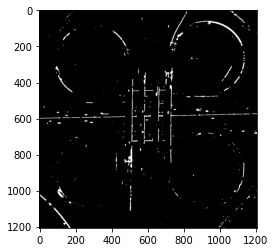

In [ ]:
fin = np.copy(opened)
plt.imshow(fin)

## Part 3

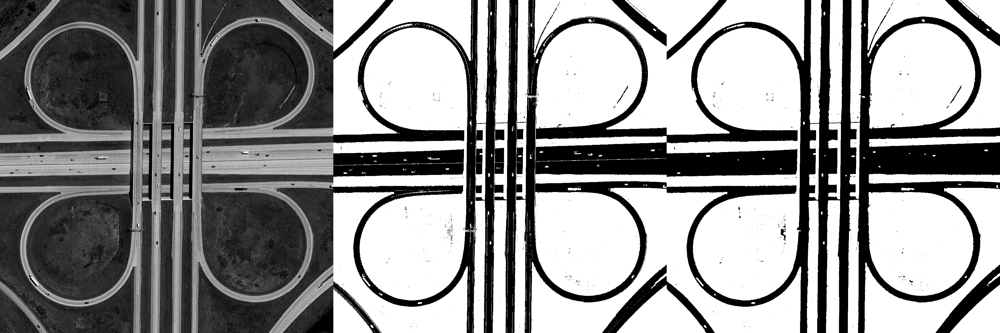

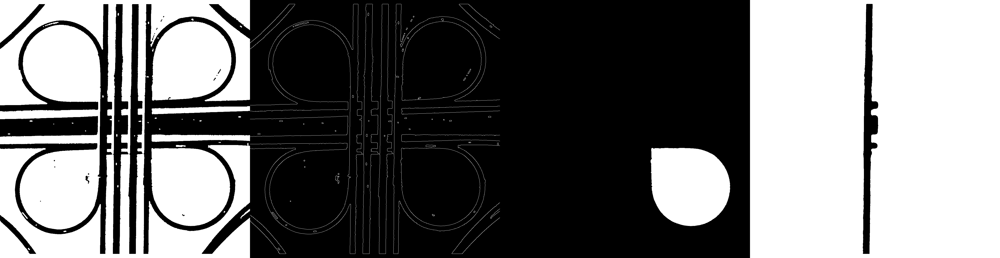

In [ ]:
road = cv2.imread('roads.jpg',0)
ret, thresh = cv2.threshold(road,100,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C)
ele = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
ele = ele.astype(np.int8)
ele[0] = -1
ele[-1] = -1
# ele[2:-2] = -1
# print(ele)
opened1 = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, morp.disk(2))

closed = cv2.morphologyEx(opened1, cv2.MORPH_CLOSE, morp.disk(2))
# opened1 = 255 - opened1
ker = np.array([[1,-1,1],[1,-1,1],[1,-1,1]])
# closed=cv2.morphologyEx(opened1,cv2.MORPH_HITMISS,ele)
im = np.full((road.shape[0]+40,road.shape[1]),255)
im[20:-20,:] = closed
closed = im.astype(np.uint8)

edges = cv2.Canny(closed, 200, 600)
#edges = cv2.dilate(edges, kernel) 
contours = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# pp = contours[0]

contours1 = contours[0] if len(contours) == 2 else contours[1]
big_contour1 = max(contours1, key=cv2.contourArea)

# draw white filled contour on black background
result0 = np.zeros_like(closed)
cv2.drawContours(result0, [big_contour1 ], 0, (255,255,255), cv2.FILLED)

# from scipy import ndimage as ndi

# fill_coins = ndi.binary_fill_holes(edges)

# opened1 = cv2.morphologyEx(closed, cv2.MORPH_OPEN, morp.disk(5))
cv2_imshow(np.hstack([road, thresh, opened1,]))
cv2_imshow(np.hstack([closed, edges, result0, temp]))

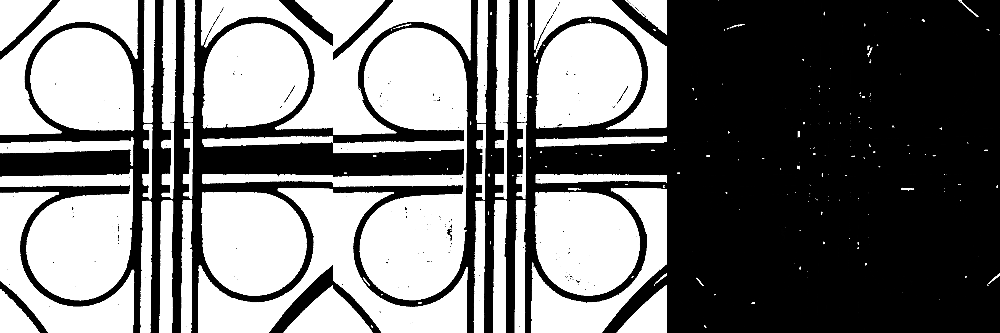

In [ ]:
fff = opened1 - opened
cv2_imshow(np.hstack([opened, opened1, fff]))

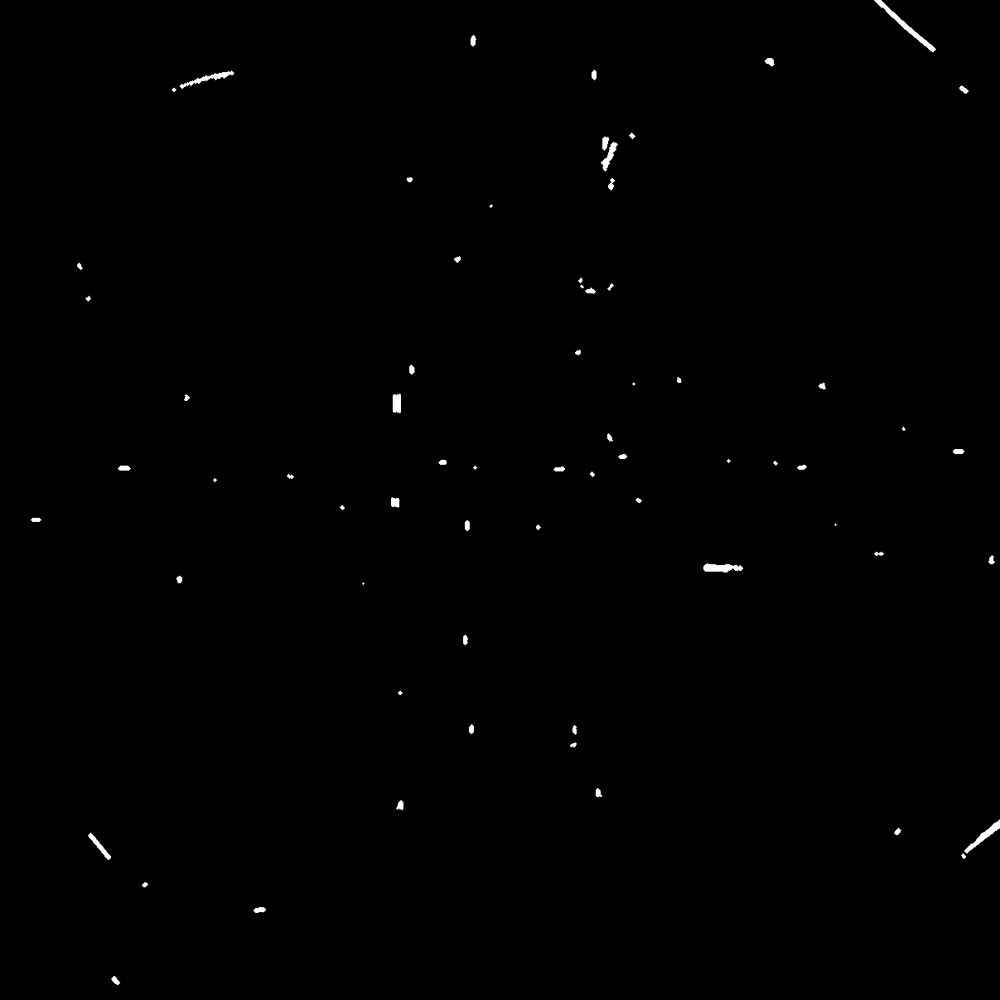

In [ ]:
ope = cv2.morphologyEx(fff, cv2.MORPH_OPEN, morp.disk(1))
clo = cv2.morphologyEx(ope, cv2.MORPH_CLOSE, morp.disk(1))
cv2_imshow(clo)

# Question 5

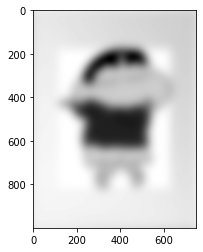

In [ ]:
im = cv2.imread("shinchan_blur.png", 0)
plt.imshow(im)

(-0.5, 999.5, 749.5, -0.5)

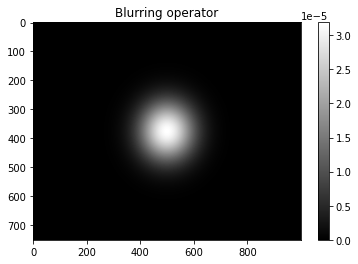

In [ ]:
Nz, Nx = [750,1000]

# Blurring guassian operator
nh = [Nz, Nx]
hz = np.exp(-0.0001*np.linspace(-(nh[0]//2), nh[0]//2, nh[0])**2)
hx = np.exp(-0.0001*np.linspace(-(nh[1]//2), nh[1]//2, nh[1])**2)
hz /= np.trapz(hz) # normalize the integral to 1
hx /= np.trapz(hx) # normalize the integral to 1
h = hz[:, np.newaxis] * hx[np.newaxis, :]

fig, ax = plt.subplots(1, 1)
him = ax.imshow(h, cmap = "gray")
ax.set_title('Blurring operator')
fig.colorbar(him, ax=ax)
ax.axis('tight')

In [ ]:
im.shape, h.transpose().shape

((1000, 750), (1000, 750))

In [ ]:
fim = np.fft.fft2(im)
fh = np.fft.fft2(h.transpose())

In [ ]:
zz = fim*fh

In [ ]:
izz = np.fft.ifft2(zz)


In [ ]:
def show_image_large(img, size=(4, 4)):
  fig, ax = plt.subplots(figsize=size)
  ax.axis("off")
  ax.imshow(img, cmap="gray")
  fig.tight_layout()

In [ ]:
def shift_fft(x):
  axes = tuple(range(x.ndim))
  shift = [dim // 2 for dim in x.shape]
  return np.roll(x, shift, axes)

def plot_fft(fft_data):
  shifted_fft = shift_fft(fft_data)
  show_image_large(np.log(np.abs(shifted_fft)))

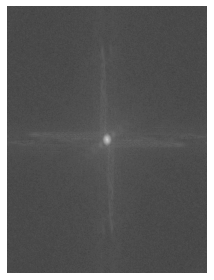

In [ ]:
plot_fft(fim)

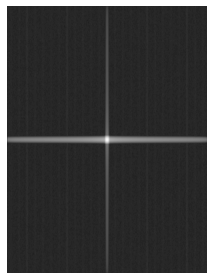

In [ ]:
plot_fft(fh)

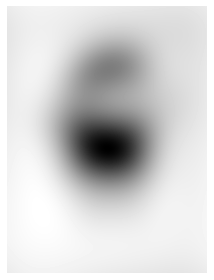

In [ ]:
plot_fft(izz)

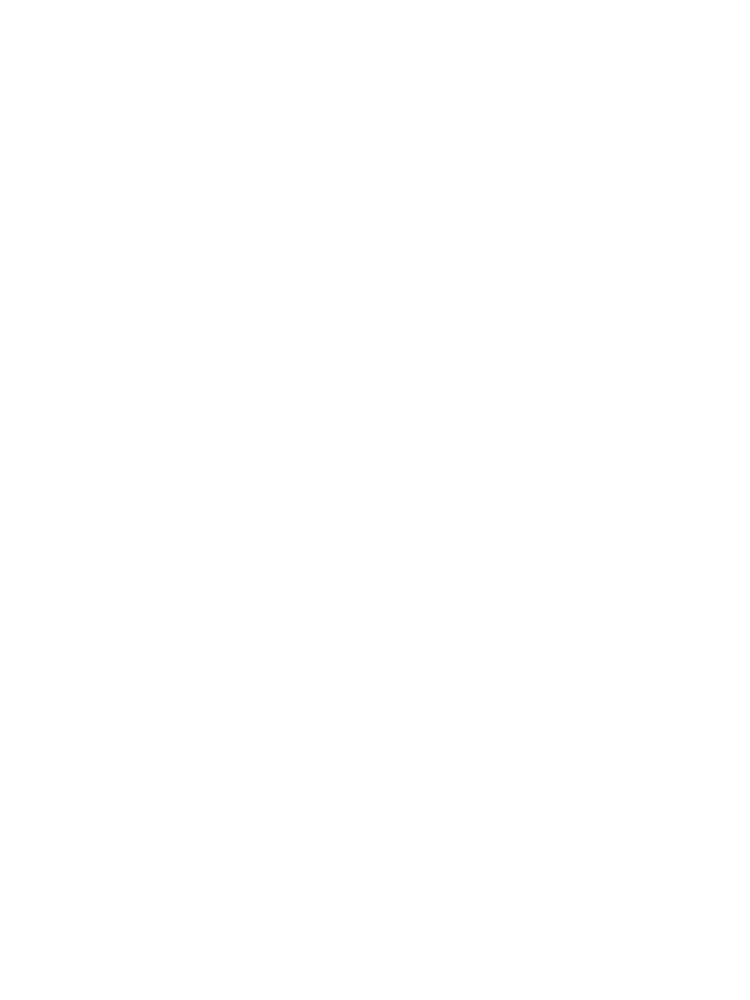

In [ ]:
res = np.abs(np.fft.fftshift(izz)) 
cv2_imshow(res)

In [ ]:
deblurred = np.fft.fft2(res) / fh

TypeError: ignored

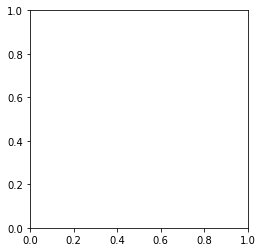

In [ ]:
plt.imshow(deblurred)

# Question 6

In [100]:
import pickle
shinchan_img = []
with (open('shinchan.pkl', 'rb')) as pkl_file:
  # shinchan_pkl = pickle.load(pkl_file)
  while True:
        try:
            shinchan_img.append(pickle.load(pkl_file))
        except EOFError:
            break
# print(shinchan_img[:10])
file.close()
# cv2_imshow(shinchan_pkl)

In [141]:
q6chan = shinchan_img[0]


In [160]:
import json
test = np.array(json.loads(q6chan))
shape = test.shape

In [142]:
import re
import numpy as np
from PIL import Image
from tqdm import tqdm
print("Huffman Compression Program")
print("=================================================================")

my_string = q6chan
letters = []
only_letters = []
for letter in tqdm(my_string):
    if letter not in letters:
        frequency = my_string.count(letter)             #frequency of each letter repetition
        letters.append(frequency)
        letters.append(letter)
        only_letters.append(letter)

nodes = []
while len(letters) > 0:
    nodes.append(letters[0:2])
    letters = letters[2:]                               # sorting according to frequency
nodes.sort()
huffman_tree = []
huffman_tree.append(nodes)                             #Make each unique character as a leaf node

def combine_nodes(nodes):
    pos = 0
    newnode = []
    if len(nodes) > 1:
        nodes.sort()
        nodes[pos].append("1")                       # assigning values 1 and 0
        nodes[pos+1].append("0")
        combined_node1 = (nodes[pos] [0] + nodes[pos+1] [0])
        combined_node2 = (nodes[pos] [1] + nodes[pos+1] [1])  # combining the nodes to generate pathways
        newnode.append(combined_node1)
        newnode.append(combined_node2)
        newnodes=[]
        newnodes.append(newnode)
        newnodes = newnodes + nodes[2:]
        nodes = newnodes
        huffman_tree.append(nodes)
        combine_nodes(nodes)
    return huffman_tree                                     # huffman tree generation

newnodes = combine_nodes(nodes)

huffman_tree.sort(reverse = True)
print("Huffman tree with merged pathways:")

checklist = []
for level in huffman_tree:
    for node in level:
        if node not in checklist:
            checklist.append(node)
        else:
            level.remove(node)
count = 0
for level in huffman_tree:
    print("Level", count,":",level)             #print huffman tree
    count+=1
print()

letter_binary = []
if len(only_letters) == 1:
    lettercode = [only_letters[0], "0"]
    letter_binary.append(letter_code*len(my_string))
else:
    for letter in only_letters:
        code =""
        for node in checklist:
            if len (node)>2 and letter in node[1]:           #genrating binary code
                code = code + node[2]
        lettercode =[letter,code]
        letter_binary.append(lettercode)
print(letter_binary)
print("Binary code generated:")
for letter in letter_binary:
    print(letter[0], letter[1])

bitstring =""
for character in tqdm(my_string):
    for item in letter_binary:
        if character in item:
            bitstring = bitstring + item[1]
binary ="0b"+bitstring
print("Your message as binary is:") # binary code generated

uncompressed_file_size = len(my_string)*7
compressed_file_size = len(binary)-2
print("Your original file size was", uncompressed_file_size,"bits. The compressed size is:",compressed_file_size)
print("This is a saving of ",uncompressed_file_size-compressed_file_size,"bits")
# output = open("compressed.txt","w+")
print("Compressed file generated as compressed.txt")
# output = open("compressed.txt","w+")

Huffman Compression Program


100%|██████████| 16161100/16161100 [00:06<00:00, 2384911.54it/s]


Huffman tree with merged pathways:
Level 0 : [[16161100, ' ,583079614[]2']]
Level 1 : [[5971966, ' ,', '1'], [10189134, '583079614[]2', '0']]
Level 2 : [[4831987, '5', '1'], [5357147, '83079614[]2', '0']]
Level 3 : [[2985983, ' ', '1'], [2985983, ',', '0'], [5357147, '83079614[]2', '0']]
Level 4 : [[2572925, '83079614[]', '1'], [2784222, '2', '0'], [2985983, ',', '0']]
Level 5 : [[1078635, '83079614', '1'], [1494290, '[]', '0'], [2985983, ' ', '1'], [4831987, '5', '1']]
Level 6 : [[747145, '[', '1'], [747145, ']', '0'], [2784222, '2', '0'], [2985983, ',', '0']]
Level 7 : [[442545, '83', '1'], [636090, '079614', '0'], [747145, ']', '0'], [2985983, ' ', '1'], [4831987, '5', '1']]
Level 8 : [[245116, '0796', '1'], [390974, '14', '0'], [747145, '[', '1'], [2784222, '2', '0'], [2985983, ',', '0']]
Level 9 : [[209610, '8', '1'], [232935, '3', '0'], [390974, '14', '0'], [747145, ']', '0'], [2985983, ' ', '1'], [4831987, '5', '1']]
Level 10 : [[185703, '1', '1'], [205271, '4', '0'], [232935, '

100%|██████████| 16161100/16161100 [00:32<00:00, 494845.32it/s]

Your message as binary is:
Your original file size was 113127700 bits. The compressed size is: 44760136
This is a saving of  68367564 bits
Compressed file generated as compressed.txt


In [146]:
s = bitstring
i = 0
buffer = bytearray()
while i < len(s):
    buffer.append( int(s[i:i+8], 2) )
    i += 8

# now write your buffer to a file
with open("ac.bin", 'bw') as f:
    f.write(buffer)

In [153]:
print("Decoding.......")
bitstring = str(binary[2:])
uncompressed_string =""
code =""
for digit in tqdm(bitstring)      :
    code = code+digit
    pos=0                                        #iterating and decoding
    for letter in letter_binary:
        if code ==letter[1]:
            uncompressed_string=uncompressed_string+letter_binary[pos] [0]
            code=""
        pos+=1

print("Your UNCOMPRESSED data is:")
if h == 1:
    temp = re.findall(r'\d+', uncompressed_string)
    res = list(map(int, temp))
    res = np.array(res)
    res = res.astype(np.uint8)
    res = np.reshape(res, shape)
    print(res)
    print("Observe the shapes and input and output arrays are matching or not")
    print("Input image dimensions:",shape)
    print("Output image dimensions:",res.shape)
    data = Image.fromarray(res)
    data.save('uncompressed.png')
    # if a.all() == res.all():
    #     print("Success")
if h == 2:
    temp = re.findall(r'\d+', uncompressed_string)
    res = list(map(int, temp))
    print(res)
    res = np.array(res)
    res = res.astype(np.uint8)
    res = np.reshape(res, (1024, 720))
    print(res)
    data = Image.fromarray(res)
    data.save('uncompressed.png')
    print("Success")

Decoding.......


100%|██████████| 44760136/44760136 [01:55<00:00, 387904.40it/s]


Your UNCOMPRESSED data is:
[[[255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]
  ...
  [255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]]

 [[255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]
  ...
  [255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]]

 [[255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]
  ...
  [255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]]

 ...

 [[255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]
  ...
  [255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]]

 [[255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]
  ...
  [255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]]

 [[255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]
  ...
  [255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]]]
Observe the shapes and input and output arrays are matching or not
Input image dimensions: (648, 1152, 4)
Output image dimensions: (648, 1152, 4)


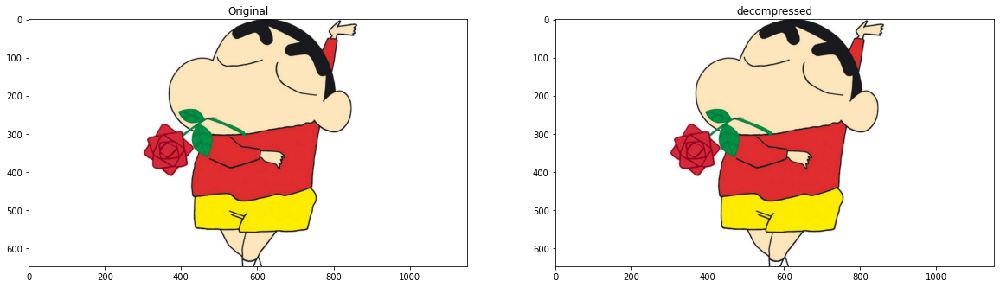

In [159]:
fig = plt.figure(figsize=(20,20))

fig.add_subplot(121)
plt.title('Original')
# plt.set_cmap('gray')
plt.imshow(test)

fig.add_subplot(122)
plt.title('decompressed')
plt.imshow(cv2.cvtColor(cv2.imread("uncompressed.png"), cv2.COLOR_BGR2RGB))

plt.show()